# Guaranteed global nonlinear optimization via interval methods


## David P. Sanders


### Department of Physics, Faculty of Sciences 
### Universidad Nacional Autónoma de México (UNAM)

#### JuMP-dev 2019, Santiago, Chile, 14 March 2019

## Outline

- Motivation and examples


- Numerical methods for computing with sets: intervals


- Global nonlinear optimization: spatial interval branch and bound (exhaustive search)


- Branch and prune: Constraint propagation

In [2]:
# ] add IntervalArithmetic#fastpowers
# ] add IntervalConstraintProgramming#separators_from_contractors  # ?
# ] add ModelingToolkit#master

using IntervalArithmetic, IntervalOptimisation
using IntervalConstraintProgramming, IntervalRootFinding
using StaticArrays, ModelingToolkit, LinearAlgebra

include("constraints.jl"); include("unify_solutions.jl")

unify_solutions (generic function with 1 method)

## Goal

- Find **global** minimum and minimizer(s) of $f: \mathbb{R}^n \to \mathbb{R}$

    i.e. $\mathbf{x}^* \colon\ f(\mathbf{x}^*) \le f(\mathbf{x}) \quad \forall \mathbf{x} \in \mathbb{R}^n $

- 
    ...with bounds that are **guaranteed** to be correct (mathematically rigorous), including bounding all floating-point errors

- Solution: Calculate with **sets** or real numbers (instead of single numbers)

- Give interval bound (`lower..upper`) on the **range** of $f$ over a set $X$

In [2]:
G(X) = 1 + sum(X.^2) / 4000 - prod( cos(X[i] / √i) for i in 1:length(X) )   # Griewank
h(x) = G(x - 1.5) * G(x-1) * G(x+1) * G(x + 1.5)

h (generic function with 1 method)

In [2]:
using Plots; gr()

Plots.GRBackend()

In [3]:
p = plot(h, -50:0.001:50, leg=false)

UndefVarError: UndefVarError: h not defined

In [5]:
@format midpoint 3

using ForwardDiff

@time rts = IntervalRootFinding.roots(x->ForwardDiff.derivative(h, x), -50..50);  rts

  2.600955 seconds (8.69 M allocations: 366.117 MiB, 8.16% gc time)


75-element Array{Root{Interval{Float64}},1}:
 Root(49.3 ± 7.11e-15, :unique) 
 Root(47.2 ± 7.11e-15, :unique) 
 Root(45 ± 7.11e-15, :unique)   
 Root(44 ± 7.11e-15, :unique)   
 Root(42.9 ± 7.11e-15, :unique) 
 Root(40.9 ± 7.11e-15, :unique) 
 Root(38.7 ± 7.11e-15, :unique) 
 Root(37.7 ± 7.11e-15, :unique) 
 Root(36.6 ± 7.11e-15, :unique) 
 Root(34.6 ± 7.11e-15, :unique) 
 Root(32.5 ± 7.11e-15, :unique) 
 Root(31.4 ± 1.07e-14, :unique) 
 Root(30.3 ± 3.56e-15, :unique) 
 ⋮                              
 Root(-31.4 ± 3.56e-15, :unique)
 Root(-32.5 ± 7.11e-15, :unique)
 Root(-34.6 ± 7.11e-15, :unique)
 Root(-36.6 ± 7.11e-15, :unique)
 Root(-37.7 ± 7.11e-15, :unique)
 Root(-38.7 ± 7.11e-15, :unique)
 Root(-40.9 ± 7.11e-15, :unique)
 Root(-42.9 ± 7.11e-15, :unique)
 Root(-44 ± 7.11e-15, :unique)  
 Root(-45 ± 7.11e-15, :unique)  
 Root(-47.2 ± 7.11e-15, :unique)
 Root(-49.3 ± 7.11e-15, :unique)

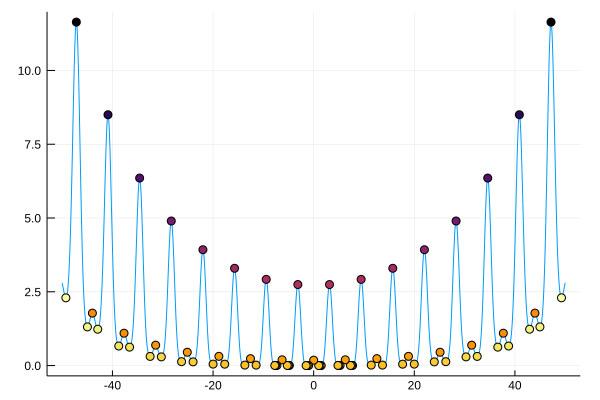

In [6]:
mids = mid.(interval.(rts))
second_deriv(f, x) = ForwardDiff.derivative(x->ForwardDiff.derivative(f, x), x)

scatter!(mids, h.(mids), marker_z = second_deriv.(h, mids))

In [76]:
@time globalmin, minimizers = IntervalOptimisation.minimize(h, -50..50, tol=1e-5);

globalmin

In [8]:
sort(unify_solutions(minimizers))

4-element Array{Interval{Float64},1}:
     -1.5 ± 2.94e-06
 -1 ± 6.01e-06      
  1 ± 2.94e-06      
      1.5 ± 3.03e-06

In [9]:
minimizers2 = mid.(minimizers);

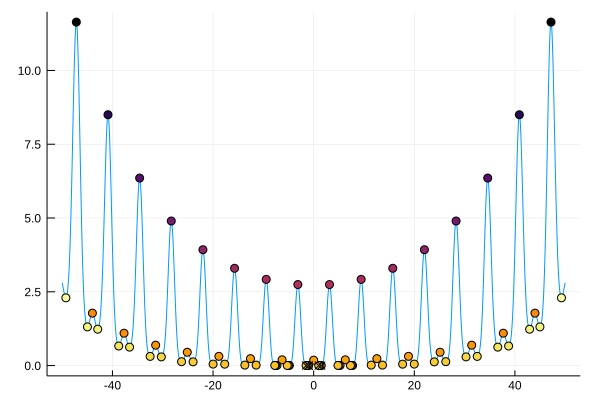

In [10]:
scatter!(minimizers2, h.(minimizers2), m=:x, ms=3)

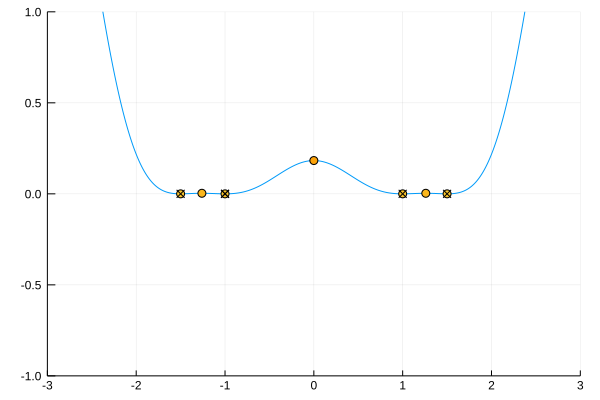

In [11]:
xlims!(-3, 3)
ylims!(-1, 1)
plot!()

## Example: Ground state 

- $N$ interacting atoms at positions $\mathbf{x}_i \in \mathbb{R}^3$


- Minimize **potential energy** to get "ground state", e.g. protein structure
        
    $$V(\mathbf{x}_1, \ldots, \mathbf{x}_N) := \sum_{i=1}^N \sum_{j > i} V(\| \mathbf{x}_i - \mathbf{x}_j \|)$$


- e.g. Lennard-Jones, $V(r) := 4 (r^{-12} - r^{-6})$

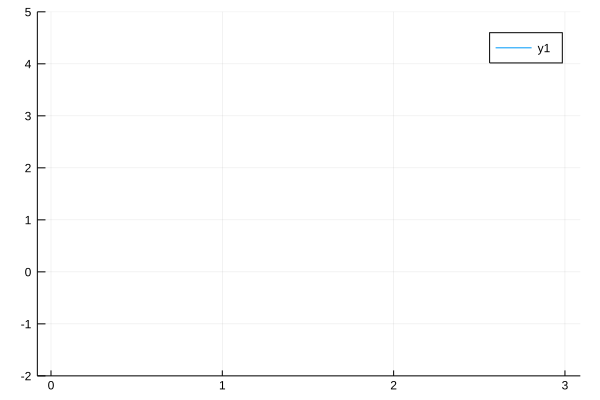

In [12]:
V(r) = 4 * (r^-12 - r^-6)

using Plots
plot(0.01:0.01:3, V, ylim=(-2, 5))

- Stochastic methods optimize for $N \sim 5000$


- Global optimality proof for $N = 5$ using interval methods (Vanaret 2014)


- `Couenne` and `Baron` report infeasible values

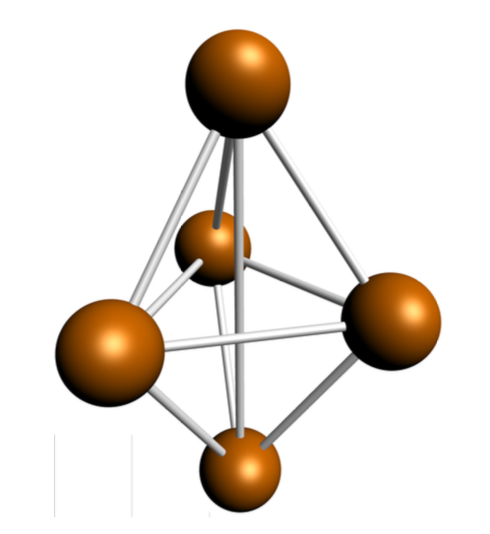

## Local minima: roots of $\nabla f$

- Find local minima of smooth function as **roots** of $\nabla f

- Proof of existence and uniqueness: **interval Newton method**

In [12]:
all(isunique, rts)

true

In [26]:
second_deriv(G, x) = ForwardDiff.derivative(x->ForwardDiff.derivative(G, x), x)

second_deriv (generic function with 1 method)

In [50]:
p = plot(h, -50:0.001:50)
scatter!(minimizers, [m for i in 1:length(minimizers)])

mids = mid.(interval.(rts))
scatter!(mids, h.(mids), ms=2, marker_z=second_deriv.(G, mids))

WebIO.mount(this.previousSibling,{"props":{},"nodeType":"Scope","type":"node","instanceArgs":{"imports":{"data":[{"name":"Plotly","type":"js","url":"/assetserver/079847aa1a9c657b7780fa2db6fcf645c667bbe4-plotly-latest.min.js"},{"name":null,"type":"js","url":"/assetserver/d07aba6698c723ddec21653493e066bda4deffe3-plotly_webio.bundle.js"}],"type":"async_block"},"id":"scope-13df1f7c-5e33-4df7-a1b2-378602ef8baa","handlers":{"_toImage":[(function (options){return this.Plotly.toImage(this.plotElem,options).then((function (data){return WebIO.setval({"name":"image","scope":"scope-13df1f7c-5e33-4df7-a1b2-378602ef8baa","id":"ob_165","type":"observable"},data)}))})],"__get_gd_contents":[(function (prop){prop=="data" ? (WebIO.setval({"name":"__gd_contents","scope":"scope-13df1f7c-5e33-4df7-a1b2-378602ef8baa","id":"ob_166","type":"observable"},this.plotElem.data)) : undefined; return prop=="layout" ? (WebIO.setval({"name":"__gd_contents","scope":"scope-13df1f7c-5e33-4df7-a1b2-378602ef8baa","id":"ob_166","type":"observable"},this.plotElem.layout)) : undefined})],"_promises":{"importsLoaded":[(function (Plotly){var gd=this.dom.querySelector("#plot-0a07aeb5-ea0a-4895-87c8-089178769b73"); this.plotElem=gd; this.Plotly=Plotly; (window.Blink!==undefined) ? (gd.style.width="100%", gd.style.height="100vh", gd.style.marginLeft="0%", gd.style.marginTop="0vh") : undefined; window.onresize=(function (){return Plotly.Plots.resize(gd)}); Plotly.newPlot(gd,[],{"margin":{"l":50,"b":50,"r":50,"t":60}},{}); gd.on("plotly_hover",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"hover"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"hover","scope":"scope-13df1f7c-5e33-4df7-a1b2-378602ef8baa","id":"ob_161","type":"observable"},filtered_data.out)) : undefined})); gd.on("plotly_unhover",(function (){return WebIO.setval({"name":"hover","scope":"scope-13df1f7c-5e33-4df7-a1b2-378602ef8baa","id":"ob_161","type":"observable"},{})})); gd.on("plotly_selected",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"selected"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"selected","scope":"scope-13df1f7c-5e33-4df7-a1b2-378602ef8baa","id":"ob_162","type":"observable"},filtered_data.out)) : undefined})); gd.on("plotly_deselect",(function (){return WebIO.setval({"name":"selected","scope":"scope-13df1f7c-5e33-4df7-a1b2-378602ef8baa","id":"ob_162","type":"observable"},{})})); gd.on("plotly_relayout",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"relayout"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"relayout","scope":"scope-13df1f7c-5e33-4df7-a1b2-378602ef8baa","id":"ob_164","type":"observable"},filtered_data.out)) : undefined})); return gd.on("plotly_click",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"click"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"click","scope":"scope-13df1f7c-5e33-4df7-a1b2-378602ef8baa","id":"ob_163","type":"observable"},filtered_data.out)) : undefined}))})]},"_downloadImage":[(function (options){return this.Plotly.downloadImage(this.plotElem,options)})],"_commands":[(function (args){var fn=args.shift(); var elem=this.plotElem; var Plotly=this.Plotly; args.unshift(elem); return Plotly[fn].apply(this,args)})]},"systemjs_options":null,"observables":{"_toImage":{"sync":false,"id":"ob_168","value":{}},"hover":{"sync":false,"id":"ob_161","value":{}},"selected":{"sync":false,"id":"ob_162","value":{}},"__gd_contents":{"sync":false,"id":"ob_166","value":{}},"click":{"sync":false,"id":"ob_163","value":{}},"image":{"sync":true,"id":"ob_165","value":""},"__get_gd_contents":{"sync":false,"id":"ob_170","value":""},"_downloadImage":{"sync":false,"id":"ob_169","value":{}},"relayout":{"sync":false,"id":"ob_164","value":{}},"_commands":{"sync":false,"id":"ob_167","value":["relayout",{"showlegend":true,"xaxis":{"showticklabels":true,"gridwidth":0.5,"tickvals":[-40.0,-20.0,0.0,20.0,40.0],"visible":true,"

In [51]:
G2(X) = 1 + sum(X.^2) / 4000 - prod( cos(X[i] / √i) for i in 1:length(X) )
G2(x, y) = G2(SVector(x, y))

G2 (generic function with 2 methods)

In [52]:
rts = roots(∇(G), IntervalBox(-10..10, 2), Krawczyk)

59-element Array{Root{IntervalBox{2,Float64}},1}:
 Root(9.43 ± 6.16e-05 × 8.89 ± 8.71e-05, :unique)    
 Root(7.85 ± 2.42e-06 × 6.66 ± 3.42e-06, :unique)    
 Root(6.28 ± 4.04e-08 × 8.88 ± 5.7e-08, :unique)     
 Root(9.42 ± 6.67e-05 × 4.44 ± 9.42e-05, :unique)    
 Root(9.43 ± 6.83e-05 × -8.4e-09 ± 9.66e-05, :unique)
 Root(7.86 ± 4.73e-09 × 2.23 ± 6.69e-09, :unique)    
 Root(6.29 ± 2.33e-08 × 4.45 ± 3.3e-08, :unique)     
 Root(6.28 ± 4.73e-05 × 8.38e-07 ± 0.000106, :unique)
 Root(3.14 ± 2.43e-08 × 8.89 ± 3.44e-08, :unique)    
 Root(1.31e-06 ± 0.000166 × 8.88 ± 0.000202, :unique)
 Root(4.72 ± 2.9e-06 × 6.67 ± 4.1e-06, :unique)      
 Root(1.57 ± 5.89e-09 × 6.66 ± 8.33e-09, :unique)    
 Root(3.14 ± 2.11e-08 × 4.44 ± 2.98e-08, :unique)    
 ⋮                                                   
 Root(-1.57 ± 3.1e-06 × -2.22 ± 4.38e-06, :unique)   
 Root(-4.71 ± 0.000264 × -2.22 ± 0.000373, :unique)  
 Root(-3.14 ± 2.84e-09 × -4.44 ± 4.01e-09, :unique)  
 Root(-1.57 ± 4.95e-06 × -6.66 ±

In [20]:
@time rts = roots(∇(G), IntervalBox(-600..600, 2), Krawczyk, 1e-8)

 32.037732 seconds (67.68 M allocations: 4.556 GiB, 5.20% gc time)


206281-element Array{Root{IntervalBox{2,Float64}},1}:
 Root([599.701, 599.702] × [599.129, 599.13], :unique)     
 Root([598.938, 598.939] × [598.051, 598.052], :unique)    
 Root([598.012, 598.013] × [592.643, 592.644], :unique)    
 Root([599.703, 599.704] × [590.254, 590.255], :unique)    
 Root([596.562, 596.563] × [594.692, 594.693], :unique)    
 Root([595.793, 595.794] × [593.604, 593.605], :unique)    
 Root([597.242, 597.243] × [591.553, 591.554], :unique)    
 Root([593.422, 593.423] × [599.13, 599.131], :unique)     
 Root([592.654, 592.655] × [598.045, 598.046], :unique)    
 Root([594.867, 594.868] × [597.088, 597.089], :unique)    
 Root([594.099, 594.1] × [596.001, 596.002], :unique)      
 Root([593.423, 593.424] × [590.255, 590.256], :unique)    
 Root([590.283, 590.284] × [594.693, 594.694], :unique)    
 ⋮                                                         
 Root([-599.704, -599.703] × [-590.255, -590.254], :unique)
 Root([-591.731, -591.73] × [-592.649, -592.64

In [53]:
stability(f, X) = count(eigvals(ForwardDiff.hessian(f, X)) .> 0)  # can make rigorous

r = -10:0.1:10
surface(r, r, G, alpha=0.8)

mids = mid.(interval.(rts))

scatter!(first.(mids), last.(mids), G2.(mids), marker_z=stability.(G2, mids), alpha=0.7)

WebIO.mount(this.previousSibling,{"props":{},"nodeType":"Scope","type":"node","instanceArgs":{"imports":{"data":[{"name":"Plotly","type":"js","url":"/assetserver/079847aa1a9c657b7780fa2db6fcf645c667bbe4-plotly-latest.min.js"},{"name":null,"type":"js","url":"/assetserver/d07aba6698c723ddec21653493e066bda4deffe3-plotly_webio.bundle.js"}],"type":"async_block"},"id":"scope-e3cf2d4c-9062-427b-9b2d-a82037e06699","handlers":{"_toImage":[(function (options){return this.Plotly.toImage(this.plotElem,options).then((function (data){return WebIO.setval({"name":"image","scope":"scope-e3cf2d4c-9062-427b-9b2d-a82037e06699","id":"ob_175","type":"observable"},data)}))})],"__get_gd_contents":[(function (prop){prop=="data" ? (WebIO.setval({"name":"__gd_contents","scope":"scope-e3cf2d4c-9062-427b-9b2d-a82037e06699","id":"ob_176","type":"observable"},this.plotElem.data)) : undefined; return prop=="layout" ? (WebIO.setval({"name":"__gd_contents","scope":"scope-e3cf2d4c-9062-427b-9b2d-a82037e06699","id":"ob_176","type":"observable"},this.plotElem.layout)) : undefined})],"_promises":{"importsLoaded":[(function (Plotly){var gd=this.dom.querySelector("#plot-62044f59-90fa-4301-83c8-c8e552cf41f0"); this.plotElem=gd; this.Plotly=Plotly; (window.Blink!==undefined) ? (gd.style.width="100%", gd.style.height="100vh", gd.style.marginLeft="0%", gd.style.marginTop="0vh") : undefined; window.onresize=(function (){return Plotly.Plots.resize(gd)}); Plotly.newPlot(gd,[],{"margin":{"l":50,"b":50,"r":50,"t":60}},{}); gd.on("plotly_hover",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"hover"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"hover","scope":"scope-e3cf2d4c-9062-427b-9b2d-a82037e06699","id":"ob_171","type":"observable"},filtered_data.out)) : undefined})); gd.on("plotly_unhover",(function (){return WebIO.setval({"name":"hover","scope":"scope-e3cf2d4c-9062-427b-9b2d-a82037e06699","id":"ob_171","type":"observable"},{})})); gd.on("plotly_selected",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"selected"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"selected","scope":"scope-e3cf2d4c-9062-427b-9b2d-a82037e06699","id":"ob_172","type":"observable"},filtered_data.out)) : undefined})); gd.on("plotly_deselect",(function (){return WebIO.setval({"name":"selected","scope":"scope-e3cf2d4c-9062-427b-9b2d-a82037e06699","id":"ob_172","type":"observable"},{})})); gd.on("plotly_relayout",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"relayout"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"relayout","scope":"scope-e3cf2d4c-9062-427b-9b2d-a82037e06699","id":"ob_174","type":"observable"},filtered_data.out)) : undefined})); return gd.on("plotly_click",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"click"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"click","scope":"scope-e3cf2d4c-9062-427b-9b2d-a82037e06699","id":"ob_173","type":"observable"},filtered_data.out)) : undefined}))})]},"_downloadImage":[(function (options){return this.Plotly.downloadImage(this.plotElem,options)})],"_commands":[(function (args){var fn=args.shift(); var elem=this.plotElem; var Plotly=this.Plotly; args.unshift(elem); return Plotly[fn].apply(this,args)})]},"systemjs_options":null,"observables":{"_toImage":{"sync":false,"id":"ob_178","value":{}},"hover":{"sync":false,"id":"ob_171","value":{}},"selected":{"sync":false,"id":"ob_172","value":{}},"__gd_contents":{"sync":false,"id":"ob_176","value":{}},"click":{"sync":false,"id":"ob_173","value":{}},"image":{"sync":true,"id":"ob_175","value":""},"__get_gd_contents":{"sync":false,"id":"ob_180","value":""},"_downloadImage":{"sync":false,"id":"ob_179","value":{}},"relayout":{"sync":false,"id":"ob_174","value":{}},"_commands":{"sync":false,"id":"ob_177","value":["relayout",{"showlegend":true,"paper_bgcolor":"rgba(255, 255, 255, 1.000)","annotations":[],"height":400,"margin":{"l":0,"b":20,"r":

# JuliaIntervals: https://github.com/JuliaIntervals

- Interval analysis **tools** for set computation


- **Principal authors**: Luis Benet, David P. Sanders


- **Principal contributors**: Jeffrey Sarnoff, Benoît Richard


- **GSoC**: Eeshan Gupta, Yashvardhan Sharma?


- Applications in other packages: 

    - EAGO.jl - sophisticated global optimization

    - JuliaReach - reachability analysis for dynamical systems


# Interval arithmetic: calculating with sets

- Idea: given a function $f$, find guaranteed **bounds** on $\color{green}{\quad \text{range}(f; X) := \{ f(x) : x \in X \}}$ 

- Work with closed **intervals**:

    $$X = [a, b] := \{ x\in \mathbb{R} : a \le x \le b \}$$

- Define **interval extension** $\tilde{f}$ of $f$:

> For input interval $X$, output $\tilde{f}(X)$ is new interval that **encloses** (bounds) $\text{range}(f; X)$


## Obtaining enclosures

- We want an *operational* way to calculate, e.g. $f(X) = X^2$

 $$[1, 2]^2 = [1, 4]$$

$$[-1, 2]^2 = ?$$

- General solution: split function into monotone pieces

- For $f(X) = X^2$ split $X$ as 

    $$X = (X \cap (-\infty, 0]) \quad \cup \quad (X \cap [0, \infty) )$$

\begin{align}
[a, b]^2 &:= [a^2, b^2] & \text{if } a \ge 0 \\ 
&:= [0, \max(a^2, b^2)]  &  \text{if } a < 0 \text{ and } b > 0\\
&:= [b^2, a^2] & \text{if } a < b < 0
\end{align}

In [56]:
using IntervalArithmetic

In [77]:
@format standard
X = -1..2   

In [13]:
X^2 

[0, 4]

## Binary operations:

- Define binary arithmetic operations on intervals:

    $$X \circ Y := \{ x \circ y : x \in X, y \in Y \}$$


- Operational definition: 

 $$[a, b] + [c, d] = [a + c, b + d]$$

In [14]:
X = -1..2;  Y = 3..4;  (X, Y)

([-1, 2], [3, 4])

In [15]:
X + Y, X - Y, X * Y, X / Y

([2, 6], [-5, -1], [-4, 8], [-0.334, 0.667])

In [16]:
X ∩ Y, X ∪ Y

(∅, [-1, 4])

In [17]:
X - X

[-3, 3]

## Fundamental theorem of interval arithmetic

- Define the **natural interval extension** $f(X)$ by:

> "replace $x$ by interval $X$ everywhere; use interval operations"

- Theorem: 

> $f(X)$ encloses the true $\mathrm{range}(f; X) := \{f(x): x \in X \}$

## Bounding functions using intervals

In [4]:
using Interact, Plots
gr()

function mince(x::Interval, n) 
    nodes = range(x.lo, x.hi, length=n+1)
    
    return [Interval(nodes[i], nodes[i+1]) for i in 1:length(nodes) - 1]
end

function bound_function(f, X, N, ylims=(-2, 2))  
    @manipulate for N in slider(1:200, value=1)
        intervals = mince(X, N)    
        images = f.(intervals)

        boxes = [IntervalBox(intervals[i], images[i]) for i in 1:length(intervals)]
        contains_zero = [0 ∈ images[i] for i in 1:length(images)]

        if length(boxes[contains_zero]) > 0
            plot(boxes[contains_zero], ylim=ylims)   # uses "plot recipe" for IntervalBoxes
        end

        if length(boxes[.!(contains_zero)]) > 0
            plot!(boxes[.!(contains_zero)], ylim=ylims)  
        end
        
        plot!(X.lo:0.0001:X.hi, f, lw=3, leg=false)
    end
end

HTML{String}("    <script class='js-collapse-script'>\n        var curMatch =\n            window.location.href\n            .match(/(.*?)\\/notebooks\\/.*\\.ipynb/);\n\n        curMatch = curMatch ||\n            window.location.href\n            .match(/(.*?)\\/apps\\/.*\\.ipynb/);\n\n        if ( curMatch ) {\n            \$('head').append('<base href=\"' + curMatch[1] + '/\">');\n        }\n    </script>\n")

HTML{String}("<script class='js-collapse-script' src='/assetserver/a1b73b8a610c7572f4a81a27d42ecc3e3a054c7e-assets/webio/dist/bundle.js'></script>")

HTML{String}("<script class='js-collapse-script' src='/assetserver/a1b73b8a610c7572f4a81a27d42ecc3e3a054c7e-assets/providers/ijulia_setup.js'></script>")

HTML{String}("  <script class='js-collapse-script'>\n    \$('.js-collapse-script').parent('.output_subarea').css('padding', '0');\n  </script>\n")

bound_function (generic function with 2 methods)

In [5]:
bound_function(x -> x^2 - 2x, -1..3, 50, (-10, 15))

Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:N=>Widget{:slider,Int64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64} with 1 listeners. Value:
0,:value=>Observable{Int64} with 2 listeners. Value:
1), Observable{Int64} with 2 listeners. Value:
1, Scope("knockout-component-5cf76981-eac3-4a66-9eb6-aeffc385524f", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any[nothing], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-left")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>200,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: value, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-center")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-right")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("changes"=>(Observable{Int64} with 1 listeners. Value:
0, nothing),"value"=>(Observable{Int64} with 2 listeners. Value:
1, nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/PH56C/src/../assets/main.css"], Dict{Any,Any}("_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            })\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            })\n            ko.applyBindingsToNode(element, { value: stringified, valueUpdate: allBindings.get('valueUpdate')}, context);\n        }\n    };\n    var json_data = JSON.parse(\"{\\\"changes\\\":0,\\\"value\\\":1}\");\n    var self = this;\n    function AppViewModel() {\n        for (var key in json_data) {\n            var el = json_data[key];\n            this[key] = Array.isArray(el) ? ko.observableArray(el) : ko.observable(el);\n        }\n        \n        \n        [this[\"changes\"].subscribe((function (val){!(this.valueFromJulia[\"changes\"]) ? (WebIO.setval({\"name\":\"changes\",\"scope\":\"knockout-component-5cf76981-eac3-4a66-9eb6-aeffc385524f\",\"id\":\"ob_02\",\"type\":\"observable\"},val)) : undefined; return this.valueFromJulia[\"changes\"]=false}),self),this[\"value\"].subscribe((function (val){!(this.valueFromJulia[\"value\"]) ? (WebIO.setval({\"name\":\"value\",\"scope\":\"knockout-component-5cf76981-eac3-4a66-9eb6-aeffc385524f\",\"id\":\"ob_01\",\"type\":\"observable\"},val)) : undefined; return this.valueFromJulia[\"value\"]=false}),self)]\n        \n    }\n

In [6]:
bound_function(x -> cos(x) + 0.5*sin(2*x), -5..5,  50, (-2,2))

Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:N=>Widget{:slider,Int64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64} with 1 listeners. Value:
0,:value=>Observable{Int64} with 2 listeners. Value:
1), Observable{Int64} with 2 listeners. Value:
1, Scope("knockout-component-4fa2ba3a-ba98-49a4-a986-0c6963f7aaae", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any[nothing], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-left")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>200,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: value, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-center")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-right")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("changes"=>(Observable{Int64} with 1 listeners. Value:
0, nothing),"value"=>(Observable{Int64} with 2 listeners. Value:
1, nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/PH56C/src/../assets/main.css"], Dict{Any,Any}("_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            })\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            })\n            ko.applyBindingsToNode(element, { value: stringified, valueUpdate: allBindings.get('valueUpdate')}, context);\n        }\n    };\n    var json_data = JSON.parse(\"{\\\"changes\\\":0,\\\"value\\\":1}\");\n    var self = this;\n    function AppViewModel() {\n        for (var key in json_data) {\n            var el = json_data[key];\n            this[key] = Array.isArray(el) ? ko.observableArray(el) : ko.observable(el);\n        }\n        \n        \n        [this[\"changes\"].subscribe((function (val){!(this.valueFromJulia[\"changes\"]) ? (WebIO.setval({\"name\":\"changes\",\"scope\":\"knockout-component-4fa2ba3a-ba98-49a4-a986-0c6963f7aaae\",\"id\":\"ob_07\",\"type\":\"observable\"},val)) : undefined; return this.valueFromJulia[\"changes\"]=false}),self),this[\"value\"].subscribe((function (val){!(this.valueFromJulia[\"value\"]) ? (WebIO.setval({\"name\":\"value\",\"scope\":\"knockout-component-4fa2ba3a-ba98-49a4-a986-0c6963f7aaae\",\"id\":\"ob_06\",\"type\":\"observable\"},val)) : undefined; return this.valueFromJulia[\"value\"]=false}),self)]\n        \n    }\n

In [7]:
bound_function(x -> (1/50) * log(abs(3 *  (1 - x) + 1)) + x^2 + 1, 0.8..2.0, 100, (1, 4))

Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:N=>Widget{:slider,Int64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64} with 1 listeners. Value:
0,:value=>Observable{Int64} with 2 listeners. Value:
1), Observable{Int64} with 2 listeners. Value:
1, Scope("knockout-component-2d123a66-c7ee-4543-ac65-0858930793c0", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any[nothing], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-left")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>200,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: value, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-center")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-right")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("changes"=>(Observable{Int64} with 1 listeners. Value:
0, nothing),"value"=>(Observable{Int64} with 2 listeners. Value:
1, nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/PH56C/src/../assets/main.css"], Dict{Any,Any}("_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            })\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            })\n            ko.applyBindingsToNode(element, { value: stringified, valueUpdate: allBindings.get('valueUpdate')}, context);\n        }\n    };\n    var json_data = JSON.parse(\"{\\\"changes\\\":0,\\\"value\\\":1}\");\n    var self = this;\n    function AppViewModel() {\n        for (var key in json_data) {\n            var el = json_data[key];\n            this[key] = Array.isArray(el) ? ko.observableArray(el) : ko.observable(el);\n        }\n        \n        \n        [this[\"changes\"].subscribe((function (val){!(this.valueFromJulia[\"changes\"]) ? (WebIO.setval({\"name\":\"changes\",\"scope\":\"knockout-component-2d123a66-c7ee-4543-ac65-0858930793c0\",\"id\":\"ob_12\",\"type\":\"observable\"},val)) : undefined; return this.valueFromJulia[\"changes\"]=false}),self),this[\"value\"].subscribe((function (val){!(this.valueFromJulia[\"value\"]) ? (WebIO.setval({\"name\":\"value\",\"scope\":\"knockout-component-2d123a66-c7ee-4543-ac65-0858930793c0\",\"id\":\"ob_11\",\"type\":\"observable\"},val)) : undefined; return this.valueFromJulia[\"value\"]=false}),self)]\n        \n    }\n

In [8]:
bound_function(x -> sin(1 / x), 0.01..0.2, (-1, 1))

Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:N=>Widget{:slider,Int64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64} with 1 listeners. Value:
0,:value=>Observable{Int64} with 2 listeners. Value:
1), Observable{Int64} with 2 listeners. Value:
1, Scope("knockout-component-38cfe254-326f-4db4-ae85-334f1280c909", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any[nothing], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-left")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>200,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: value, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-center")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-right")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("changes"=>(Observable{Int64} with 1 listeners. Value:
0, nothing),"value"=>(Observable{Int64} with 2 listeners. Value:
1, nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/PH56C/src/../assets/main.css"], Dict{Any,Any}("_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            })\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            })\n            ko.applyBindingsToNode(element, { value: stringified, valueUpdate: allBindings.get('valueUpdate')}, context);\n        }\n    };\n    var json_data = JSON.parse(\"{\\\"changes\\\":0,\\\"value\\\":1}\");\n    var self = this;\n    function AppViewModel() {\n        for (var key in json_data) {\n            var el = json_data[key];\n            this[key] = Array.isArray(el) ? ko.observableArray(el) : ko.observable(el);\n        }\n        \n        \n        [this[\"changes\"].subscribe((function (val){!(this.valueFromJulia[\"changes\"]) ? (WebIO.setval({\"name\":\"changes\",\"scope\":\"knockout-component-38cfe254-326f-4db4-ae85-334f1280c909\",\"id\":\"ob_17\",\"type\":\"observable\"},val)) : undefined; return this.valueFromJulia[\"changes\"]=false}),self),this[\"value\"].subscribe((function (val){!(this.valueFromJulia[\"value\"]) ? (WebIO.setval({\"name\":\"value\",\"scope\":\"knockout-component-38cfe254-326f-4db4-ae85-334f1280c909\",\"id\":\"ob_16\",\"type\":\"observable\"},val)) : undefined; return this.valueFromJulia[\"value\"]=false}),self)]\n        \n    }\n

## Example application: Roots

In [11]:
using IntervalArithmetic
@format standard

X = 3..4;  (X, typeof(X))  # make an interval

([3, 4], Interval{Float64})

In [12]:
X^2

[9, 16]

In [13]:
f(x) = x^2 - 2;  f(X)   

[7, 14]

In [14]:
0 ∈ f(X) 

false

- So have *theorem*: $\ f$ has **no root** in $X$

In [27]:
0 ∈ f(2..∞)

false

## Higher dimensions: interval boxes

- In dimension $d>1$ use **boxes** = Cartesian product of intervals

In [28]:
XX = (3..4) × (5..6)   # \times <TAB>

[3, 4] × [5, 6]

In [29]:
XX = IntervalBox(3..4, 5..6)

[3, 4] × [5, 6]

In [30]:
f(X) = ( (x, y) = X; IntervalBox(x^2 + y^2 - 1, x - y) )
f(XX)

[33, 51] × [-3, -1]

In [31]:
XX = IntervalBox(3..4, 10)

[3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4]

##  Composability

In [32]:
using ForwardDiff, StaticArrays

ForwardDiff.derivative(X -> X^2 - 2X, -2..2)   

[-6, 2]

In [33]:
ff(XX) = ( (X, Y) = XX; SVector(X^2 + Y^2, X - Y) )
 
J = ForwardDiff.jacobian(ff, SVector(big(3..4), 5..6) )

J^-1  

2×2 SArray{Tuple{2,2},Interval{BigFloat},2,4}:
 [0.0499, 0.0625]₂₅₆   [0.499, 0.75]₂₅₆
 [0.0499, 0.0625]₂₅₆  [-0.5, -0.299]₂₅₆

- Gives **enclosure** of derivatives over the interval, i.e. of $\{f'(x): x \in X\}$


- `ForwardDiff.jl` knows **nothing** about `IntervalArithmetic.jl`; they just **compose** beautifully

# Global optimization: spatial branch & bound

- **Branch**: bisect


- **Bound**: throw away all boxes whose image is above current global minimum

In [15]:
m = 10.0   # running upper bound on global minimum

f(x) = x^2 - 2

f(5..10) > m  # throw away box 5..10

true

In [3]:
using Interact, Plots, IntervalArithmetic

function calculate_branch_bound(f, X, N)
    interval_lists = [[X]]
    m = mid(X)
    
    upper_bound = X.hi
    upper_bounds = [upper_bound]
    
    working_list = [X]
    
    for i in 1:N
        X = popfirst!(working_list)
        
        upper_bound = min(upper_bound, f(interval(mid(X))).hi)
        
        if f(X).lo <= upper_bound
            X1, X2 = bisect(X)
            push!(working_list, X1, X2)
        end
        
        push!(interval_lists, copy(working_list))
        push!(upper_bounds, upper_bound)
    end
            
    
    return interval_lists, upper_bounds
end

function visualize_branch_bound(f, X, N)
    interval_lists, upper_bounds = calculate_branch_bound(f, X, N)
    
    @manipulate for i in slider(1:N, value=1)
        Xs = interval_lists[i]
        plot(IntervalBox.(Xs[2:end], f.(Xs[2:end])))
        plot!(IntervalBox(Xs[1], f(Xs[1])), ylim=(-10, 5))
        hline!([upper_bounds[i+1]], ls=:dash, lw=2)
        plot!(X.lo:0.001:X.hi, f, lw=3, ylim=(-12, 12), leg=false, alpha=0.8)
        scatter!([ (mid(Xs[1]), f(mid(Xs[1])) ) ])

    end
end

HTML{String}("    <script class='js-collapse-script'>\n        var curMatch =\n            window.location.href\n            .match(/(.*?)\\/notebooks\\/.*\\.ipynb/);\n\n        curMatch = curMatch ||\n            window.location.href\n            .match(/(.*?)\\/apps\\/.*\\.ipynb/);\n\n        if ( curMatch ) {\n            \$('head').append('<base href=\"' + curMatch[1] + '/\">');\n        }\n    </script>\n")

HTML{String}("<script class='js-collapse-script' src='/assetserver/a1b73b8a610c7572f4a81a27d42ecc3e3a054c7e-assets/webio/dist/bundle.js'></script>")

HTML{String}("<script class='js-collapse-script' src='/assetserver/a1b73b8a610c7572f4a81a27d42ecc3e3a054c7e-assets/providers/ijulia_setup.js'></script>")

HTML{String}("  <script class='js-collapse-script'>\n    \$('.js-collapse-script').parent('.output_subarea').css('padding', '0');\n  </script>\n")

visualize_branch_bound (generic function with 1 method)

In [4]:
gr()
visualize_branch_bound(x -> x * sin(x), -10..8, 100)

Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:i=>Widget{:slider,Int64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64} with 1 listeners. Value:
0,:value=>Observable{Int64} with 2 listeners. Value:
1), Observable{Int64} with 2 listeners. Value:
1, Scope("knockout-component-5cf76981-eac3-4a66-9eb6-aeffc385524f", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any[nothing], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-left")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>100,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: value, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-center")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-right")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("changes"=>(Observable{Int64} with 1 listeners. Value:
0, nothing),"value"=>(Observable{Int64} with 2 listeners. Value:
1, nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/PH56C/src/../assets/main.css"], Dict{Any,Any}("_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            })\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            })\n            ko.applyBindingsToNode(element, { value: stringified, valueUpdate: allBindings.get('valueUpdate')}, context);\n        }\n    };\n    var json_data = JSON.parse(\"{\\\"changes\\\":0,\\\"value\\\":1}\");\n    var self = this;\n    function AppViewModel() {\n        for (var key in json_data) {\n            var el = json_data[key];\n            this[key] = Array.isArray(el) ? ko.observableArray(el) : ko.observable(el);\n        }\n        \n        \n        [this[\"changes\"].subscribe((function (val){!(this.valueFromJulia[\"changes\"]) ? (WebIO.setval({\"name\":\"changes\",\"scope\":\"knockout-component-5cf76981-eac3-4a66-9eb6-aeffc385524f\",\"id\":\"ob_02\",\"type\":\"observable\"},val)) : undefined; return this.valueFromJulia[\"changes\"]=false}),self),this[\"value\"].subscribe((function (val){!(this.valueFromJulia[\"value\"]) ? (WebIO.setval({\"name\":\"value\",\"scope\":\"knockout-component-5cf76981-eac3-4a66-9eb6-aeffc385524f\",\"id\":\"ob_01\",\"type\":\"observable\"},val)) : undefined; return this.valueFromJulia[\"value\"]=false}),self)]\n        \n    }\n

## Simple branch & bound algorithm: Moore&ndash;Skelboe

1. Working list $L := [X]$; minimizers $R := []$; upper bound for global min $m := \infty$


2. Extract $X$ from $L$, e.g. first 


3. If $f(X) > m$, delete $X$


4. If $\mathrm{diam}(X) < \epsilon$, push $X$ into $R$


5. "Local minimization", e.g. $M := f(\mathrm{mid}(X))$; 
if $M < m$, set $m := M$.


6. Bisect $X$ and push $X_1$ and $X_2$ into $L$.

In [16]:
function simple_minimize(f, X, ϵ=1e-3)
    L = [X]; R = typeof(X)[ ]; m = ∞   

    while !isempty(L)
        X = popfirst!(L)  # first element: queue

        f(X).lo > m && continue 

        diam(X) < ϵ && ( push!(R, X); continue )

        current_max = sup.(f(Interval.(mid(X))))   # evaluate at midpoint
        current_max < m && (m = current_max)

        push!(L, bisect(X)...)
    end

    minimizers = filter(X -> f(X).lo <= m, R)  # remove infeasible boxes
    lower_bound = reduce(∪, f.(minimizers)).lo

    return interval(lower_bound, m), minimizers
end

simple_minimize (generic function with 2 methods)

In [17]:
@format 4

@time m, R = simple_minimize(x->(x^2 - 2)^2 - 2, -10..10)
m, unify_solutions(R)

  0.326914 seconds (976.81 k allocations: 49.954 MiB, 6.14% gc time)


([-2, -1.999], Interval{Float64}[[-1.415, -1.413], [1.413, 1.415]])

## Surprisingly efficient for "weakly-nonconvex" functions

- Non-convex **Griewank function** in $n$ dimensions: 

    $$G(\mathbf{x}) = 1 + \frac{1}{4000} \sum_{i=1}^n x_i^2 - \prod_{i=1}^n \cos \left( \frac{x_i}{\sqrt{i}} \right) $$

In [39]:
G(X) = 1 + sum(abs2, X) / 4000 - prod(cos(X[i] / √i) for i in 1:length(X))
G(x, y) = G([x, y])

G (generic function with 2 methods)

In [40]:
using Plots
plotlyjs()

r = -10:0.1:10
surface(r, r, G, alpha=0.8)

WebIO.mount(this.previousSibling,{"props":{},"nodeType":"Scope","type":"node","instanceArgs":{"imports":{"data":[{"name":"Plotly","type":"js","url":"/assetserver/079847aa1a9c657b7780fa2db6fcf645c667bbe4-plotly-latest.min.js"},{"name":null,"type":"js","url":"/assetserver/d07aba6698c723ddec21653493e066bda4deffe3-plotly_webio.bundle.js"}],"type":"async_block"},"id":"scope-595bc1ed-c9fe-444e-95ef-5769466794f8","handlers":{"_toImage":[(function (options){return this.Plotly.toImage(this.plotElem,options).then((function (data){return WebIO.setval({"name":"image","scope":"scope-595bc1ed-c9fe-444e-95ef-5769466794f8","id":"ob_30","type":"observable"},data)}))})],"__get_gd_contents":[(function (prop){prop=="data" ? (WebIO.setval({"name":"__gd_contents","scope":"scope-595bc1ed-c9fe-444e-95ef-5769466794f8","id":"ob_31","type":"observable"},this.plotElem.data)) : undefined; return prop=="layout" ? (WebIO.setval({"name":"__gd_contents","scope":"scope-595bc1ed-c9fe-444e-95ef-5769466794f8","id":"ob_31","type":"observable"},this.plotElem.layout)) : undefined})],"_promises":{"importsLoaded":[(function (Plotly){var gd=this.dom.querySelector("#plot-1715f4ed-389a-40a3-a8f0-288f22336bff"); this.plotElem=gd; this.Plotly=Plotly; (window.Blink!==undefined) ? (gd.style.width="100%", gd.style.height="100vh", gd.style.marginLeft="0%", gd.style.marginTop="0vh") : undefined; window.onresize=(function (){return Plotly.Plots.resize(gd)}); Plotly.newPlot(gd,[],{"margin":{"l":50,"b":50,"r":50,"t":60}},{}); gd.on("plotly_hover",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"hover"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"hover","scope":"scope-595bc1ed-c9fe-444e-95ef-5769466794f8","id":"ob_26","type":"observable"},filtered_data.out)) : undefined})); gd.on("plotly_unhover",(function (){return WebIO.setval({"name":"hover","scope":"scope-595bc1ed-c9fe-444e-95ef-5769466794f8","id":"ob_26","type":"observable"},{})})); gd.on("plotly_selected",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"selected"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"selected","scope":"scope-595bc1ed-c9fe-444e-95ef-5769466794f8","id":"ob_27","type":"observable"},filtered_data.out)) : undefined})); gd.on("plotly_deselect",(function (){return WebIO.setval({"name":"selected","scope":"scope-595bc1ed-c9fe-444e-95ef-5769466794f8","id":"ob_27","type":"observable"},{})})); gd.on("plotly_relayout",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"relayout"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"relayout","scope":"scope-595bc1ed-c9fe-444e-95ef-5769466794f8","id":"ob_29","type":"observable"},filtered_data.out)) : undefined})); return gd.on("plotly_click",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"click"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"click","scope":"scope-595bc1ed-c9fe-444e-95ef-5769466794f8","id":"ob_28","type":"observable"},filtered_data.out)) : undefined}))})]},"_downloadImage":[(function (options){return this.Plotly.downloadImage(this.plotElem,options)})],"_commands":[(function (args){var fn=args.shift(); var elem=this.plotElem; var Plotly=this.Plotly; args.unshift(elem); return Plotly[fn].apply(this,args)})]},"systemjs_options":null,"observables":{"_toImage":{"sync":false,"id":"ob_33","value":{}},"hover":{"sync":false,"id":"ob_26","value":{}},"selected":{"sync":false,"id":"ob_27","value":{}},"__gd_contents":{"sync":false,"id":"ob_31","value":{}},"click":{"sync":false,"id":"ob_28","value":{}},"image":{"sync":true,"id":"ob_30","value":""},"__get_gd_contents":{"sync":false,"id":"ob_35","value":""},"_downloadImage":{"sync":false,"id":"ob_34","value":{}},"relayout":{"sync":false,"id":"ob_29","value":{}},"_commands":{"sync":false,"id":"ob_32","value":["relayout",{"showlegend":true,"paper_bgcolor":"rgba(255, 255, 255, 1.000)","annotations":[],"height":400,"margin":{"l":0,"b":20,"r":0,"t":20},"plot_bgc

In [41]:
minimize(G, -∞..∞)

([0, 0], Interval{Float64}[[-0.0002141, 0.0003656]])

In [42]:
minimize(G, (-∞..∞) × (-∞..∞))

([0, 0], IntervalBox{2,Float64}[[-0.0002141, 0.0003656] × [-0.0002141, 0.0003656]])

In [43]:
@time minimize(G, IntervalBox(-∞..∞, 10))

  1.062323 seconds (2.65 M allocations: 149.457 MiB, 8.31% gc time)


([0, 0], IntervalBox{10,Float64}[[-0.0002141, 0.0003656] × [-0.0002141, 0.0003656] × [-0.0002141, 0.0003656] × [-0.0002141, 0.0003656] × [-0.0002141, 0.0003656] × [-0.0002141, 0.0003656] × [-0.0002141, 0.0003656] × [-0.0002141, 0.0003656] × [-0.0002141, 0.0003656] × [-0.0002141, 0.0003656]])

- For any $d$, global optimum has value $0$ at $\mathbf{x} = \mathbf{0}$

Let's calculate times to minimize in $n$ dimensions. First we compile the relevant functions (Julia will compile a specialized version for each dimensions; this is quite slow):

In [4]:
@time [minimize(G, IntervalBox(-1..1, n)) for n in 1:100];

557.937106 seconds (1.22 G allocations: 43.516 GiB, 6.93% gc time)


Now we calculate elapsed times as a function of dimension, averaging over 5 runs of each:

In [18]:
using Statistics, IntervalOptimisation, DataStructures

ns = round.(Int, exp10.(0.5:0.1:2));

times = [mean(@elapsed minimize(G, IntervalBox(-Inf..Inf, n), structure=PriorityQueue, tol=1e-3) for i in 1:1) for n in ns]

16-element Array{Float64,1}:
  0.047125893
  0.059960213
  0.078880569
  0.117399454
  0.176000395
  0.419019153
  0.30607843 
  0.611570159
  0.611098067
  1.027070045
  1.558141788
  2.0452499  
  3.684541522
  5.379538481
  8.331970314
 12.333660268

In [128]:
using Plots

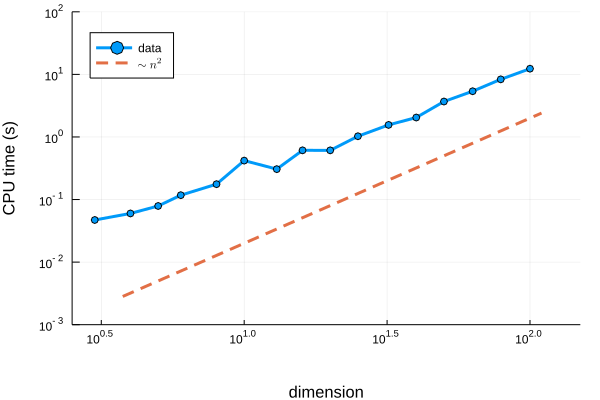

In [19]:
using LaTeXStrings, Interact

gr()
times_plot = plot(ns, times, m=:o, scale=:log10, ylims=(1e-3, 10), ms=3, label="data", lw=3)
plot!(x->2e-4*x^2, ls=:dash, label=L"\sim n^2", leg=:topleft, bottom_margin = 10*Interact.mm, lw=3)
xlabel!("dimension")
ylabel!("CPU time (s)")
xlims!(2.5, 150)
ylims!(0.001, 100)

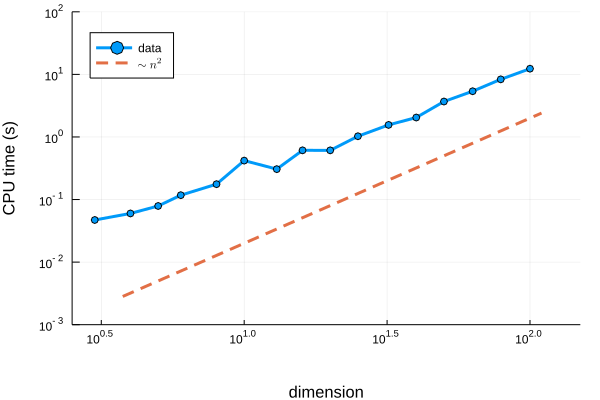

In [20]:
times_plot

In [109]:
savefig("griewank_times.pdf")

## Local minima: roots of $\nabla f$

- Find local minima of smooth function as **roots** of $\nabla f$


- Proof of existence and uniqueness: **interval Newton method**

In [44]:
using IntervalRootFinding

@time rts = roots(∇(G), IntervalBox(-10..10, 2), Krawczyk)

  3.492976 seconds (12.76 M allocations: 506.712 MiB, 13.40% gc time)


59-element Array{Root{IntervalBox{2,Float64}},1}:
 Root([9.429, 9.43] × [8.894, 8.895], :unique)          
 Root([7.849, 7.85] × [6.658, 6.659], :unique)          
 Root([6.28, 6.281] × [8.876, 8.877], :unique)          
 Root([9.42, 9.421] × [4.438, 4.439], :unique)          
 Root([9.429, 9.43] × [-9.655e-05, 9.653e-05], :unique) 
 Root([7.855, 7.856] × [2.226, 2.227], :unique)         
 Root([6.286, 6.287] × [4.447, 4.448], :unique)         
 Root([6.279, 6.281] × [-6.552e-05, 6.658e-05], :unique)
 Root([3.143, 3.144] × [8.894, 8.895], :unique)         
 Root([-0.0001415, 0.0001438] × [8.876, 8.878], :unique)
 Root([4.717, 4.718] × [6.667, 6.668], :unique)         
 Root([1.566, 1.567] × [6.663, 6.664], :unique)         
 Root([3.14, 3.141] × [4.438, 4.439], :unique)          
 ⋮                                                      
 Root([-1.573, -1.572] × [-2.223, -2.222], :unique)     
 Root([-4.712, -4.71] × [-2.219, -2.217], :unique)      
 Root([-3.141, -3.14] × [-4.439, -4.43

In [20]:
@time rts = roots(∇(G), IntervalBox(-600..600, 2), Krawczyk, 1e-8)

 32.037732 seconds (67.68 M allocations: 4.556 GiB, 5.20% gc time)


206281-element Array{Root{IntervalBox{2,Float64}},1}:
 Root([599.701, 599.702] × [599.129, 599.13], :unique)     
 Root([598.938, 598.939] × [598.051, 598.052], :unique)    
 Root([598.012, 598.013] × [592.643, 592.644], :unique)    
 Root([599.703, 599.704] × [590.254, 590.255], :unique)    
 Root([596.562, 596.563] × [594.692, 594.693], :unique)    
 Root([595.793, 595.794] × [593.604, 593.605], :unique)    
 Root([597.242, 597.243] × [591.553, 591.554], :unique)    
 Root([593.422, 593.423] × [599.13, 599.131], :unique)     
 Root([592.654, 592.655] × [598.045, 598.046], :unique)    
 Root([594.867, 594.868] × [597.088, 597.089], :unique)    
 Root([594.099, 594.1] × [596.001, 596.002], :unique)      
 Root([593.423, 593.424] × [590.255, 590.256], :unique)    
 Root([590.283, 590.284] × [594.693, 594.694], :unique)    
 ⋮                                                         
 Root([-599.704, -599.703] × [-590.255, -590.254], :unique)
 Root([-591.731, -591.73] × [-592.649, -592.64

In [45]:
using ForwardDiff
stability(f, X) = count(eigvals(ForwardDiff.hessian(f, X)) .> 0)  # can make rigorous

r = -10:0.1:10
surface(r, r, G, alpha=0.8)

mids = mid.(interval.(rts))
scatter!(first.(mids), last.(mids), G.(mids), marker_z=stability.(G, mids), alpha=0.7)

WebIO.mount(this.previousSibling,{"props":{},"nodeType":"Scope","type":"node","instanceArgs":{"imports":{"data":[{"name":"Plotly","type":"js","url":"/assetserver/079847aa1a9c657b7780fa2db6fcf645c667bbe4-plotly-latest.min.js"},{"name":null,"type":"js","url":"/assetserver/d07aba6698c723ddec21653493e066bda4deffe3-plotly_webio.bundle.js"}],"type":"async_block"},"id":"scope-8241d9f0-6eba-412b-a80c-2fdf8dc2dd5a","handlers":{"_toImage":[(function (options){return this.Plotly.toImage(this.plotElem,options).then((function (data){return WebIO.setval({"name":"image","scope":"scope-8241d9f0-6eba-412b-a80c-2fdf8dc2dd5a","id":"ob_40","type":"observable"},data)}))})],"__get_gd_contents":[(function (prop){prop=="data" ? (WebIO.setval({"name":"__gd_contents","scope":"scope-8241d9f0-6eba-412b-a80c-2fdf8dc2dd5a","id":"ob_41","type":"observable"},this.plotElem.data)) : undefined; return prop=="layout" ? (WebIO.setval({"name":"__gd_contents","scope":"scope-8241d9f0-6eba-412b-a80c-2fdf8dc2dd5a","id":"ob_41","type":"observable"},this.plotElem.layout)) : undefined})],"_promises":{"importsLoaded":[(function (Plotly){var gd=this.dom.querySelector("#plot-2c7a52aa-1d27-4b11-b2e3-5d9151231761"); this.plotElem=gd; this.Plotly=Plotly; (window.Blink!==undefined) ? (gd.style.width="100%", gd.style.height="100vh", gd.style.marginLeft="0%", gd.style.marginTop="0vh") : undefined; window.onresize=(function (){return Plotly.Plots.resize(gd)}); Plotly.newPlot(gd,[],{"margin":{"l":50,"b":50,"r":50,"t":60}},{}); gd.on("plotly_hover",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"hover"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"hover","scope":"scope-8241d9f0-6eba-412b-a80c-2fdf8dc2dd5a","id":"ob_36","type":"observable"},filtered_data.out)) : undefined})); gd.on("plotly_unhover",(function (){return WebIO.setval({"name":"hover","scope":"scope-8241d9f0-6eba-412b-a80c-2fdf8dc2dd5a","id":"ob_36","type":"observable"},{})})); gd.on("plotly_selected",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"selected"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"selected","scope":"scope-8241d9f0-6eba-412b-a80c-2fdf8dc2dd5a","id":"ob_37","type":"observable"},filtered_data.out)) : undefined})); gd.on("plotly_deselect",(function (){return WebIO.setval({"name":"selected","scope":"scope-8241d9f0-6eba-412b-a80c-2fdf8dc2dd5a","id":"ob_37","type":"observable"},{})})); gd.on("plotly_relayout",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"relayout"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"relayout","scope":"scope-8241d9f0-6eba-412b-a80c-2fdf8dc2dd5a","id":"ob_39","type":"observable"},filtered_data.out)) : undefined})); return gd.on("plotly_click",(function (data){var filtered_data=WebIO.PlotlyCommands.filterEventData(gd,data,"click"); return !(filtered_data.isnil) ? (WebIO.setval({"name":"click","scope":"scope-8241d9f0-6eba-412b-a80c-2fdf8dc2dd5a","id":"ob_38","type":"observable"},filtered_data.out)) : undefined}))})]},"_downloadImage":[(function (options){return this.Plotly.downloadImage(this.plotElem,options)})],"_commands":[(function (args){var fn=args.shift(); var elem=this.plotElem; var Plotly=this.Plotly; args.unshift(elem); return Plotly[fn].apply(this,args)})]},"systemjs_options":null,"observables":{"_toImage":{"sync":false,"id":"ob_43","value":{}},"hover":{"sync":false,"id":"ob_36","value":{}},"selected":{"sync":false,"id":"ob_37","value":{}},"__gd_contents":{"sync":false,"id":"ob_41","value":{}},"click":{"sync":false,"id":"ob_38","value":{}},"image":{"sync":true,"id":"ob_40","value":""},"__get_gd_contents":{"sync":false,"id":"ob_45","value":""},"_downloadImage":{"sync":false,"id":"ob_44","value":{}},"relayout":{"sync":false,"id":"ob_39","value":{}},"_commands":{"sync":false,"id":"ob_42","value":["relayout",{"showlegend":true,"paper_bgcolor":"rgba(255, 255, 255, 1.000)","annotations":[],"height":400,"margin":{"l":0,"b":20,"r":0,"t":20},"plot_bgc

- For any $d$, global optimum has value $0$ at $\mathbf{x} = \mathbf{0}$

## Dependency and cluster effect

- **Dependency problem**: 

    Over-estimation of range using interval arithmetic when variable is repeated in expression

- In global optimization and root finding, leads to **cluster effect**:

    Cluster of boxes near minimum whose length grows when $\epsilon \to 0$

In [46]:
@time m, R = simple_minimize(x -> (x-2) * (x+2), -10..10, 1e-7);  length(R)

  0.118654 seconds (346.26 k allocations: 15.897 MiB, 10.85% gc time)


10704

## Reducing the cluster effect

- Use interval extensions with higher *order of approximation* of $\mathrm{range}(f; X)$ as $\mathrm{diam}(X) \to 0$

- **Mean-value form** (via mean-value theorem):

    \begin{align}
    f(z) &= f(m + z - m)\\
           &= f(m) + \nabla f(\xi) \cdot (z - m),  \qquad \xi \in [m, z] \\
           &\in f(m) + \nabla f(X) \cdot (X - m)
    \end{align}
           

- So set

    $$m := \text{mid}(X)$$

    $$f_1(X) := f([m]) + \nabla f(X) \cdot (X - m) \supseteq \mathrm{range}(f; X)$$

In [47]:
using ForwardDiff, LinearAlgebra

ForwardDiff.gradient(f, X::IntervalBox) = ForwardDiff.gradient(f, X.v)

function mean_value_form(f, X)
    m = IntervalBox(mid.(X))
    
    return f(m) + ForwardDiff.gradient(f, X) ⋅ (X - m)
end

mean_value_form(f) = X -> mean_value_form(f, X)

mean_value_form (generic function with 2 methods)

In [48]:
f(x, y) = x^2 - 2x*y + y^2 + 2x
f(X) = f(X[1], X[2])

ϵ = 1e-2
@time m, R1 = minimize(f, IntervalBox(-10..10, 2), tol=ϵ); @show length(R1)
@time m, R2 = minimize(mean_value_form(f), IntervalBox(-10..10, 2), tol=ϵ); @show length(R2);

  1.474115 seconds (5.61 M allocations: 870.213 MiB, 12.67% gc time)
length(R1) = 1113
  0.437879 seconds (1.36 M allocations: 56.956 MiB, 8.21% gc time)
length(R2) = 11


## Branch and prune: constraint propagation

- Bisection = very bad idea in high dimensions

- How minimise bisection?

- Suppose have candidate set $X$ and **constraint**

    e.g. $f(X) < m$ during branch and bound

- Idea: **eliminate** part of $X$ that does not satisfy constraint

- Method: (interval) **constraint propagation**

## Example

- Calculate $\{(x,y) \in \mathbb{R}^2: x^2 + y^2 \le 1 \}$


- Idea: Introduce new variable at each node of syntax tree

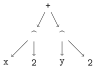

In [18]:
using TreeView

@tree x^2 + y^2

In [19]:
using IntervalArithmetic 
   
x = y = -∞..∞  # intervals

[-∞, ∞]

In [20]:
a = x^2    
b = y^2

[0, ∞]

In [51]:
c = a + b 

[0, ∞]

- Impose **constraint** $\le 1$:

In [73]:
c = c ∩ (-∞..1)   # c = x^2 + y^2 <= 1

c

[0, 1]

In [74]:
# c = a + b  ∴  a = c - b

a,  (c - b)  # currently inconsistent

([0, ∞], [-∞, 1])

In [75]:
a = a ∩ (c - b)  # make consistent

[0, 1]

In [16]:
# a = x^2
x = √a ∪ (-√a)  

[-1, 1]

- Sequence of operations gives a **contractor** that shrinks $[-\infty, \infty]^2$ to $[-1, 1]^2$

## Automate forward&ndash;backward contractor

In [21]:
using IntervalConstraintProgramming

In [22]:
# macro syntax:

C = @contractor x^2 + y^2

Contractor in 2 dimensions:
  - forward pass contracts to 1 dimensions
  - variables: Symbol[:x, :y]
  - expression: x ^ 2 + y ^ 2

In [77]:
 using ModelingToolkit
 
@variables x y      # master branch

(x, y)

In [78]:
f(x, y ) = x^2 + y^2

f(x, y)

x ^ 2 + y ^ 2

In [73]:
C = Contractor(f(x, y))

Contractor in 2 dimensions:
  - forward pass contracts to 1 dimensions
  - variables: Symbol[:xx, :yy]
  - expression: xx ^ 2 + yy ^ 2

In [74]:
using MacroTools

MacroTools.striplines(C.forward.code)

quote
    t->begin
            (xx, yy) = t
            begin
                _d = xx ^ 2
                _e = yy ^ 2
                _f = _d + _e
            end
            return (_f, (_d, _e))
        end
end

In [76]:
MacroTools.striplines(C.backward.code)  # using reverse (inverse) functions

quote
    (t1, t2, t3)->begin
            (xx, yy) = t1
            (_f,) = t2
            (_d, _e) = t3
            begin
                (_f, _d, _e) = plus_rev(_f, _d, _e)
                (_e, yy, _) = power_rev(_e, yy, 2)
                (_d, xx, _) = power_rev(_d, xx, 2)
            end
            return (xx, yy)
        end
end

In [23]:
using Interact
gr()

Plots.GRBackend()

In [24]:
using IntervalConstraintProgramming 

C = @constraint 2 <= x^3 + y^2 <= 5

X = (-5..5) × (-5..5)  # \times<TAB>

@manipulate for n in slider(-0.0:0.5:8, value=-0.0)
    ϵ = 2.0^(-n)
    paving = pave(C, X, ϵ)
    
    plot(paving.inner, aspect_ratio=:equal, leg=false)
    plot!(paving.boundary, title="area: $(Vol(paving).bounds)")
end

Widget{:manipulate,Any}(OrderedDict{Symbol,Any}(:n=>Widget{:slider,Float64}(OrderedDict{Symbol,Any}(:changes=>Observable{Int64} with 1 listeners. Value:
0,:index=>Observable{Any} with 2 listeners. Value:
1,:formatted_vals=>Observable{Any} with 1 listeners. Value:
["0.0", "0.5", "1.0", "1.5", "2.0", "2.5", "3.0", "3.5", "4.0", "4.5", "5.0", "5.5", "6.0", "6.5", "7.0", "7.5", "8.0"],:formatted_value=>Observable{String} with 1 listeners. Value:
"0.0",:value=>Observable{Float64} with 2 listeners. Value:
-0.0), Observable{Float64} with 2 listeners. Value:
-0.0, Scope("knockout-component-595bc1ed-c9fe-444e-95ef-5769466794f8", Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :label), Any[nothing], Dict{Symbol,Any}(:className=>"interact ",:style=>Dict{Any,Any}(:padding=>"5px 10px 0px 10px")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-left")), 2), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :input), Any[], Dict{Symbol,Any}(:max=>17,:min=>1,:attributes=>Dict{Any,Any}(:type=>"range",Symbol("data-bind")=>"numericValue: index, valueUpdate: 'input', event: {change : function () {this.changes(this.changes()+1)}}","orient"=>"horizontal"),:step=>1,:className=>"slider slider is-fullwidth",:style=>Dict{Any,Any}()), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-center")), 1), Node{DOM}(DOM(:html, :div), Any[Node{DOM}(DOM(:html, :p), Any[], Dict{Symbol,Any}(:attributes=>Dict("data-bind"=>"text: formatted_value")), 0)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row-right")), 1)], Dict{Symbol,Any}(:attributes=>Dict("class"=>"interact-flex-row")), 7), Dict{String,Tuple{Observables.AbstractObservable,Union{Nothing, Bool}}}("formatted_vals"=>(Observable{Any} with 1 listeners. Value:
["0.0", "0.5", "1.0", "1.5", "2.0", "2.5", "3.0", "3.5", "4.0", "4.5", "5.0", "5.5", "6.0", "6.5", "7.0", "7.5", "8.0"], nothing),"changes"=>(Observable{Int64} with 1 listeners. Value:
0, nothing),"formatted_value"=>(Observable{String} with 1 listeners. Value:
"0.0", nothing),"index"=>(Observable{Any} with 2 listeners. Value:
1, nothing)), Set(String[]), nothing, Any["knockout"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout.js", "knockout_punches"=>"/Users/dpsanders/.julia/packages/Knockout/JIqpG/src/../assets/knockout_punches.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/all.js", "/Users/dpsanders/.julia/packages/InteractBase/PTCUD/src/../assets/style.css", "/Users/dpsanders/.julia/packages/InteractBulma/PH56C/src/../assets/main.css"], Dict{Any,Any}("formatted_vals"=>Any[JSString("(function (val){return (val!=this.model[\"formatted_vals\"]()) ? (this.valueFromJulia[\"formatted_vals\"]=true, this.model[\"formatted_vals\"](val)) : undefined})")],"_promises"=>Dict{Any,Any}("importsLoaded"=>Any[JSString("function (ko, koPunches) {\n    ko.punches.enableAll();\n    ko.bindingHandlers.numericValue = {\n        init : function(element, valueAccessor, allBindings, data, context) {\n            var stringified = ko.observable(ko.unwrap(valueAccessor()));\n            stringified.subscribe(function(value) {\n                var val = parseFloat(value);\n                if (!isNaN(val)) {\n                    valueAccessor()(val);\n                }\n            })\n            valueAccessor().subscribe(function(value) {\n                var str = JSON.stringify(value);\n                if ((str == \"0\") && ([\"-0\", \"-0.\"].indexOf(stringified()) >= 0))\n                     return;\n                 if ([\"null\", \"\"].indexOf(str) >= 0)\n                     return;\n                stringified(str);\n            })\n            ko.applyBindingsToNode(element, { value: stringified, valueUpdate: allBindings.get('valueUpdate')}, context);\n        }\n    };\n    var json_data = JSON.parse(\"{\\\"formatted_vals\\\":[\\\"0.0\\\",\\\"0.5\\\",\\\"1.0\\\",\\\"1.5\\\",\\\"2.0\\\",\\\"2.5\\\",\\\"3.0\\\",\\\"3.5\\\",\\\"4.0\\\"

# Unconstrained minimization with constraint propagation

In [44]:
using IntervalArithmetic, IntervalConstraintProgramming, ModelingToolkit
include("constraints.jl")

Separator

In [31]:
function unconstrained_minimize(C::Contractor, X, ϵ=1e-3)
    
    L = [X]; R = typeof(X)[ ]; m = ∞   

    while !isempty(L)
        X = popfirst!(L)  # first element: queue

        C(X).lo > m && continue  # C(X) is the usual forward function

        diam(X) < ϵ && ( push!(R, X); continue )

        current_max = sup.(C(IntervalBox(mid(X))))
        current_max < m && (m = current_max)
        
        X = C(interval(-∞, m), X)  # C(constraint, X) performs constraint propagation

        !isempty(X) && push!(L, bisect(X)...)
            
    end

    minimizers = filter(X -> C(X).lo <= m, R)
    lower_bound = reduce(∪, C.(minimizers)).lo

    return interval(lower_bound, m), minimizers

end

unconstrained_minimize (generic function with 2 methods)

In [27]:
f(x, y) = (1.5 - x * (1 - y))^2 + (2.25 - x * (1 - y^2))^2 + (2.625 - x * (1 - y^3))^2
f(X) = f(X[1], X[2])

C = Contractor(f)

Contractor in 2 dimensions:
  - forward pass contracts to 1 dimensions
  - variables: Symbol[:x1, :x2]
  - expression: ((1.5 - x1 * (1 - x2)) ^ 2 + (2.25 - x1 * (1 - x2 ^ 2)) ^ 2) + (2.625 - x1 * (1 - x2 ^ 3)) ^ 2

In [28]:
using IntervalOptimisation, DataStructures

In [33]:
@time m, R = minimize(f, IntervalBox(-1e2..1e2, 2), structure=PriorityQueue);

  0.693093 seconds (4.05 M allocations: 183.941 MiB, 11.25% gc time)


In [34]:
# Particularly favourable case:

@time unconstrained_minimize(C, IntervalBox(-1e2..1e2, 2), 1e-8)

  0.002922 seconds (3.71 k allocations: 204.031 KiB)


([0, 5.692e-17], IntervalBox{2,Float64}[[2.999, 3] × [0.4999, 0.5], [2.999, 3] × [0.4999, 0.5], [2.999, 3] × [0.4999, 0.5001], [2.999, 3] × [0.4999, 0.5001], [2.999, 3.001] × [0.4999, 0.5001], [3, 3.001] × [0.4999, 0.5001], [3, 3.001] × [0.5, 0.5001], [3, 3.001] × [0.5, 0.5001], [3, 3.001] × [0.5, 0.5001]])

## Constrained optimization

- Idea: **Contract** candidate box with respect to each constraint


- Finds **outer approximation** to constraint set, pruned with respect to running upper bound for global minimum


- Improvement: find **inner approximation** of constraint set using **separators**

In [64]:
using IntervalArithmetic, IntervalConstraintProgramming, ModelingToolkit
include("constraints.jl")

Separator

In [39]:
function constrained_minimize(C::Contractor, X, constraints::Vector{<:Constraint}, ϵ=1e-3)
    
    L = [X]; R = typeof(X)[ ]; m = ∞   

    while !isempty(L)
        X = popfirst!(L)  # first element: queue

        C(X).lo > m && continue  # C(X) is the usual forward function

        diam(X) < ϵ && ( push!(R, X); continue )
        
        for constraint in constraints
            X = constraint(X)
        end
        
        isempty(X) && continue

        image = C(X)   # can no longer assume we can find feasible point
        image.hi < m && (m = image.hi)
        
        X = C(interval(-∞, m), X)

        isempty(X) && continue
        
        push!(L, bisect(X)...)
    end

    minimizers = filter(X -> C(X).lo <= m, R)
    lower_bound = reduce(∪, C.(minimizers)).lo

    return interval(lower_bound, m), minimizers
end

constrained_minimize (generic function with 2 methods)

In [67]:
X = IntervalBox(-1e5..1e5, 2)

@variables x y
@time m, R = constrained_minimize(Contractor((x,y) -> x + y), X, 
                            [Constraint(x^2 + y^2 < 1)], 1e-7);

m

  0.415771 seconds (1.08 M allocations: 56.815 MiB, 8.08% gc time)


[-1.415, -1.414]

In [68]:
unify_solutions(R)

2390-element Array{IntervalBox{2,Float64},1}:
 [-0.7074, -0.7069] × [-0.7074, -0.7069]
 [-0.7074, -0.7073] × [-0.707, -0.7069] 
 [-0.7074, -0.7073] × [-0.7069, -0.7068]
 [-0.7074, -0.7073] × [-0.7069, -0.7068]
 [-0.7074, -0.7073] × [-0.7069, -0.7068]
 [-0.7074, -0.7073] × [-0.7069, -0.7068]
 [-0.7075, -0.7074] × [-0.7068, -0.7067]
 [-0.7075, -0.7074] × [-0.7068, -0.7067]
 [-0.7075, -0.7074] × [-0.7068, -0.7067]
 [-0.7075, -0.7074] × [-0.7068, -0.7067]
 [-0.7076, -0.7075] × [-0.7067, -0.7066]
 [-0.7076, -0.7075] × [-0.7067, -0.7066]
 [-0.7076, -0.7075] × [-0.7067, -0.7066]
 ⋮                                      
 [-0.7069, -0.7068] × [-0.7074, -0.7073]
 [-0.7069, -0.7068] × [-0.7074, -0.7073]
 [-0.7069, -0.7068] × [-0.7074, -0.7073]
 [-0.7069, -0.7068] × [-0.7074, -0.7073]
 [-0.7069, -0.7068] × [-0.7074, -0.7073]
 [-0.7069, -0.7068] × [-0.7074, -0.7073]
 [-0.7069, -0.7068] × [-0.7074, -0.7073]
 [-0.7069, -0.7068] × [-0.7074, -0.7073]
 [-0.7069, -0.7068] × [-0.7074, -0.7073]
 [-0.7069, 

In [36]:
# Jaulin book, p. 125 / Hansen book section 17.8

c1(p1, p2) = 12p1^2 - 6.3p1^4 + p1^6 + 6p1*p2 + 6p2^2
c1(p) = c1(p[1], p[2])

X = IntervalBox(-2..4, 2)

[-2, 4] × [-2, 4]

In [37]:
@variables p1 p2

constraints = Constraint.( [
                1 - 16p1^2 - 25p2^2 < 0,
                13p1^3 - 145p1 + 85p2 - 400 < 0,
                p1*p2 - 4 < 0
                ]  );

In [41]:
C = Contractor(c1)

@time m, R = constrained_minimize(Contractor(c1), X, constraints, 1e-6);
m

  0.406321 seconds (893.94 k allocations: 43.370 MiB, 5.25% gc time)


[0.199, 0.1991]

In [42]:
include("unify_solutions.jl")
unify_solutions(R)

91-element Array{IntervalBox{2,Float64},1}:
 [-0.06665, -0.06545] × [0.1927, 0.1931]
 [-0.0654, -0.06539] × [0.193, 0.1931]  
 [-0.06538, -0.06537] × [0.193, 0.1931] 
 [-0.06538, -0.06537] × [0.193, 0.1931] 
 [-0.06537, -0.06536] × [0.193, 0.1931] 
 [-0.06537, -0.06536] × [0.193, 0.1931] 
 [-0.06672, -0.06671] × [0.1927, 0.1928]
 [-0.06672, -0.06671] × [0.1927, 0.1928]
 [-0.06672, -0.06671] × [0.1927, 0.1928]
 [-0.06671, -0.0667] × [0.1927, 0.1928] 
 [-0.06671, -0.0667] × [0.1927, 0.1928] 
 [-0.06671, -0.0667] × [0.1927, 0.1928] 
 [-0.06671, -0.0667] × [0.1927, 0.1928] 
 ⋮                                      
 [0.06663, 0.06664] × [-0.1928, -0.1927]
 [0.06663, 0.06664] × [-0.1928, -0.1927]
 [0.06544, 0.06545] × [-0.1931, -0.193] 
 [0.06544, 0.06545] × [-0.1931, -0.193] 
 [0.06544, 0.06545] × [-0.1931, -0.193] 
 [0.06544, 0.06545] × [-0.1931, -0.193] 
 [0.06544, 0.06545] × [-0.1931, -0.193] 
 [0.06544, 0.06546] × [-0.1931, -0.193] 
 [0.06545, 0.06546] × [-0.1931, -0.193] 
 [0.06545, 0.

In [43]:
separators = Separator.(constraints)

3-element Array{IntervalConstraintProgramming.ConstraintSeparator{_1,Interval{Float64},Expr} where _1,1}:
 Separator:
  - variables: p1, p2
  - expression: (1 - 16 * p1 ^ 2) - 25 * p2 ^ 2 ∈ [-∞, 0]     
 Separator:
  - variables: p1, p2
  - expression: ((13 * p1 ^ 3 - 145p1) + 85p2) - 400 ∈ [-∞, 0]
 Separator:
  - variables: p1, p2
  - expression: p1 * p2 - 4 ∈ [-∞, 0]                         

In [44]:
paving = pave(reduce(∩, separators), X, 0.01)

Paving:
- tolerance ϵ = 0.01
- inner approx. of length 1767
- boundary approx. of length 1255

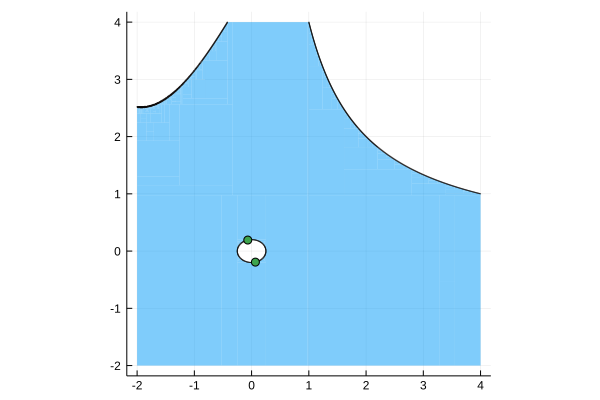

In [45]:
gr()

plot(paving.inner, leg=false, aspect_ratio=1, lw=0, alpha=0.5)
plot!(paving.boundary)

m = mid(R[1])
scatter!( [(m[1], m[2]), (-m[1], -m[2])])

## Future work


- MOI interface


- Cross-fertilization with other Julia optimization packages: `Alpine.jl`

- Constraints on derivatives: necessary conditions for (un)constrained minimization

- Tests (& docs!) &ndash; hard test cases please

- GPUs?


# Contact

- Twitter: **`@DavidPSanders`**


- http://github.com/dpsanders


- http://sistemas.fciencias.unam.mx/~dsanders


- Email: dpsanders@ciencias.unam.mx

## Roots

In [60]:
using IntervalArithmetic, IntervalRootFinding
using Interact, Plots

plotlyjs()

In [62]:
@manipulate for A in 1:20
    f(x, y) = 2A + x^2 - A*cos(2π*x) + y^2 - A*cos(2π*y)
    f(X) = f(X[1], X[2])

    L = 5.0; X = IntervalBox( -L..(L+1), 2)

    @time rts = roots(∇(f), X, Newton, 1e-10);

    surface(-5:0.1:6, -5:0.1:6, f, alpha=0.8)
    mids = mid.(interval.(rts))
    scatter!(first.(mids), last.(mids), f.(mids), alpha=0.5, ms=1, c=:blue)
end

In [14]:
stability(X) = count(eigvals(ForwardDiff.hessian(f, X)) .> 0)  # can make rigorous

stability (generic function with 1 method)

In [15]:
surface(-5:0.1:6, -5:0.1:6, f, alpha=0.8)

mids = mid.(interval.(rts))
stabilities = stability.(mids)
mins = mids[stabilities .== 2]; maxs = mids[stabilities .== 0]; stats = mids[stabilities .== 1]
scatter!(first.(mins), last.(mins), f.(mins), alpha=0.5, ms=2, c=:blue)
scatter!(first.(maxs), last.(maxs), f.(maxs), alpha=0.5, ms=2, c=:red)
scatter!(first.(stats), last.(stats), f.(stats), alpha=0.5, ms=2, c=:green)

## IntervalArithmetic.jl

Implementation:

In [ ]:
struct SimpleInterval{T <: AbstractFloat}
    lo::T
    hi::T
end

Base.:+(x::SimpleInterval, y::SimpleInterval) = @round(x.lo + y.lo, x.hi + y.hi)

In [93]:
Interval( +(x.lo, y.lo, RoundDown), +(x.hi, y.hi, RoundUp) )

LoadError: syntax: incomplete: premature end of input

In [18]:
a = 3.1..3.2

@macroexpand IntervalArithmetic.@round(a.lo + a.lo, a.hi + a.hi)

:((IntervalArithmetic.Interval)(a.lo + a.lo + RoundingMode{:Down}(), a.hi + a.hi + RoundingMode{:Up}()))

Interact.Slider{Int64}(35: "input-10" = 1 Int64 , "", 1, 1:200, "horizontal", true, "d", true)

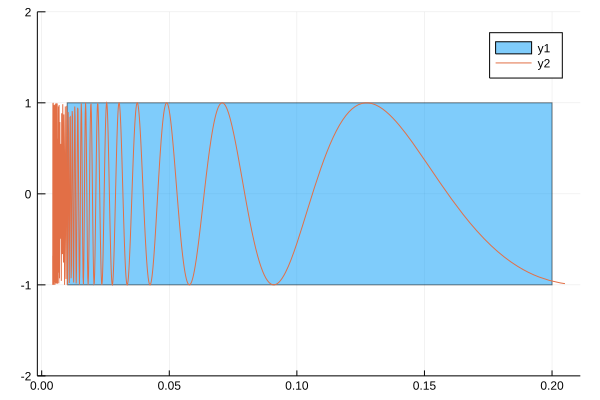

In [50]:
bound_function(x->sin(1/x), 0.01..0.2, (-1,1))

## Implementation of intervals in Julia

In [35]:
struct SimpleInterval   
    lo::Float64
    hi::Float64
end

SimpleInterval(a) = SimpleInterval(a, a)

SimpleInterval

In [36]:
a = SimpleInterval(0.1)
b = SimpleInterval(0.2)  

SimpleInterval(0.2, 0.2)

In [37]:
import Base: +, show

show(io::IO, x::SimpleInterval) = 
    print(io, "[$(x.lo), $(x.hi)]")

+(x::SimpleInterval, y::SimpleInterval) = 
    SimpleInterval(x.lo + y.lo, x.hi + y.hi) 

+ (generic function with 318 methods)

In [38]:
a = SimpleInterval(0.1, 0.1) 
b = SimpleInterval(0.2, 0.2)
a + b

[0.30000000000000004, 0.30000000000000004]

In [39]:
@code_native a + b

- **Outward rounding** guarantees correct inclusion of result

- New: Use `ErrorfreeArithmetic.jl` -- Jeffrey Sarnoff

In [40]:
using ErrorfreeArithmetic

In [41]:
ErrorfreeArithmetic.two_sum(0.1, 0.3)

(0.4, -2.7755575615628914e-17)

- Result tells how to round:

In [95]:
+(0.1,   0.3, RoundDown), +(0.1, 0.3, RoundUp)

(0.39999999999999997, 0.4)

## Guaranteed enclosure of functions

- Split interval into pieces (**mince**) and apply natural interval extension

In [96]:
function mince(x::Interval, n) 
    nodes = linspace(x.lo, x.hi, n+1)
    
    return [Interval(nodes[i], nodes[i+1]) for i in 1:length(nodes) - 1]
end

mince (generic function with 1 method)

In [97]:
f(x) = cos(x) + 0.5*sin(2*x)
 
function image(f, X)
    II = f(X)
   
    if II.lo == -Inf
        II = -100..(II.hi)
    end
    
    return II
end

image (generic function with 1 method)

In [45]:
intervals = mince(-5..5, 10)
    
images = image.(f, intervals)

10-element Array{IntervalArithmetic.Interval{Float64},1}:
 [-1.14833, 0.555673]  
 [-1.5, -0.513935]     
 [-0.850285, 0.0838532]
 [-0.870796, 0.918704] 
  [0.0403023, 1]       
  [0.540302, 1.5]      
 [-0.794549, 0.994952] 
 [-1.49, -0.555854]    
 [-1.13971, -0.153643] 
 [-0.925655, 0.778342] 

In [46]:
using Interact, Plots, IntervalArithmetic; gr()

Plots.GRBackend()

In [47]:
function bound_function(f, X, N ,ylims=(-2,2))  
    @manipulate for N in slider(1:200, value=1)
        intervals = mince(X, N)    
        images = image.(f, intervals)

        boxes = [IntervalBox(intervals[i], images[i]) for i in 1:length(intervals)]
        contains_zero = [0 ∈ images[i] for i in 1:length(images)]

        if length(boxes[contains_zero]) > 0
            plot(boxes[contains_zero], ylim=ylims)   # uses "plot recipe" for IntervalBoxes
        end

        if length(boxes[.!(contains_zero)]) > 0
            plot!(boxes[.!(contains_zero)], ylim=ylims)  
        end
        plot!(f)
    end
end

bound_function (generic function with 2 methods)

Interact.Slider{Int64}(73: "input-21" = 1 Int64 , "", 1, 1:200, "horizontal", true, "d", true)

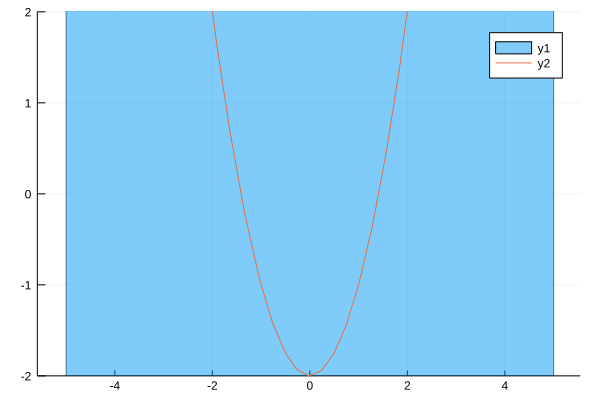

In [99]:
f(x) = cos(x) + 0.5*sin(2*x)

bound_function(f, -5..5,  50, (-2,2))

Interact.Slider{Int64}(77: "input-22" = 1 Int64 , "", 1, 1:200, "horizontal", true, "d", true)

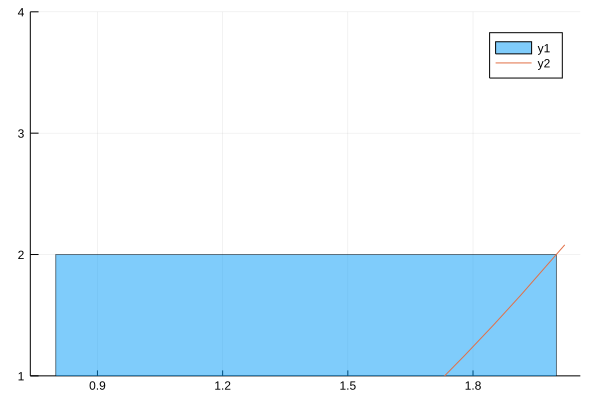

In [100]:

f(x) = (1/50)*log(abs(3*(1-x) + 1)) + x^2 + 1

bound_function(f, 0.8..2.0, 100, (1,4))


Interact.Slider{Int64}(35: "input-10" = 1 Int64 , "", 1, 1:200, "horizontal", true, "d", true)

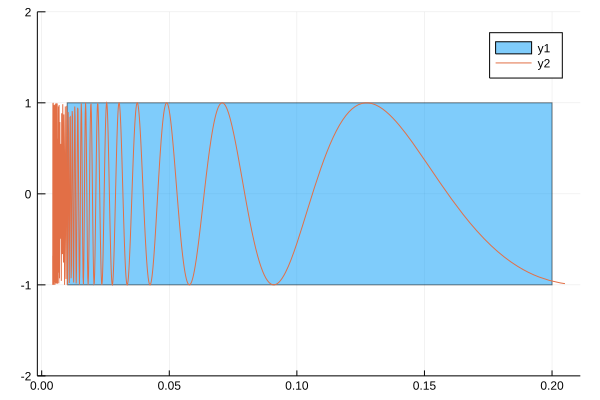

In [50]:
bound_function(x->sin(1/x), 0.01..0.2, (-1,1))

In [1]:
G(X) = 1 + sum(X.^2) / 4000 - prod( cos(X[i] / √i) for i in 1:length(X) )

G (generic function with 1 method)

In [48]:
using IntervalOptimisation

In [51]:
@time m, R = minimize(x->(x^2 - 2)^2 - 2, -10..10)   # gives lower bound for global minimum too


  0.090699 seconds (273.28 k allocations: 14.202 MiB, 7.23% gc time)


([-2, -1.99999], Interval{Float64}[[-1.41426, -1.41358], [1.41364, 1.41429]])

In [53]:
carrom(x, y) = - (exp(2*abs(1 - sqrt(x^2 + y^2) / pi)) * cos(x)^2 * cos(y)^2) / 30

carrom(X) = carrom(X[1], X[2])

carrom (generic function with 2 methods)

In [ ]:
using Plots
plotly()
surface(-5:0.1:5, -5:0.1:5, carrom)

In [1]:
using IntervalArithmetic, IntervalOptimisation, Plots

In [68]:
@time globalmin, minimisers = simple_minimize(carrom, 
                                       (-10..10) × (-10..10), 
                                       2e-3)

  0.716646 seconds (9.84 M allocations: 364.185 MiB, 7.36% gc time)


(-24.156815401271935, IntervalBox{2,Float64}[[-9.67081, -9.66962] × [-9.66846, -9.66727], [-9.67081, -9.66962] × [-9.66728, -9.66609], [-9.67197, -9.6708] × [-9.6661, -9.66489], [-9.67081, -9.66962] × [-9.6661, -9.66489], [-9.66846, -9.66727] × [-9.67081, -9.66962], [-9.66728, -9.66609] × [-9.67081, -9.66962], [-9.6661, -9.66489] × [-9.67197, -9.6708], [-9.6661, -9.66489] × [-9.67081, -9.66962], [-9.66963, -9.66845] × [-9.66963, -9.66845], [-9.66963, -9.66845] × [-9.66846, -9.66727]  …  [9.67256, 9.67377] × [9.66076, 9.66209], [9.67376, 9.67499] × [9.66076, 9.66209], [9.67498, 9.67621] × [9.65947, 9.66077], [9.6762, 9.67745] × [9.65947, 9.66077], [9.67498, 9.67621] × [9.66076, 9.66209], [9.67256, 9.67377] × [9.66208, 9.66337], [9.67376, 9.67499] × [9.66208, 9.66337], [9.67256, 9.67377] × [9.66336, 9.66467], [9.67376, 9.67499] × [9.66336, 9.66467], [9.67256, 9.67377] × [9.66466, 9.66597]])

In [3]:
@time globalmin, minimisers = minimize(carrom, 
                                       (-10..10) × (-10..10), 
                                       1e-3)

MethodError: MethodError: no method matching minimise(::typeof(carrom), ::IntervalBox{2,Float64}, ::Float64)
Closest candidates are:
  minimise(::Any, ::T; structure, tol) where T at /Users/dpsanders/.julia/dev/IntervalOptimisation/src/optimise.jl:19

In [60]:
gr()
contour(-10:0.05:10, -10:0.05:10, carrom, aspect_ratio=1)
plot!(minimisers)

  4.355988 seconds (22.18 M allocations: 807.619 MiB, 17.68% gc time)


In [351]:
XX = IntervalBox(3..4, 10)

[3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4] × [3, 4]

## Reducing the cluster effect

- Use interval extensions with higher *order of approximation*

- E.g. **mean-value form**:

    $$m := \text{mid}(X)$$

    $$f([m]) + \nabla f(X) \cdot (X - m)$$

In [11]:
import ForwardDiff
using StaticArrays, LinearAlgebra

ForwardDiff.gradient(f, X::IntervalBox) = ForwardDiff.gradient(f, X.v)

function mean_value_form(f, X)
    m = IntervalBox(mid.(X))
    
    return f(m) + ForwardDiff.gradient(f, X) ⋅ (X - m)
end

mean_value_form(f) = X -> mean_value_form(f, X)

mean_value_form (generic function with 2 methods)

In [38]:
using StaticArrays, IntervalArithmetic
 
# f(X) = X[1] * (X[1] - X[2]) + X[2] * (-X[1] + X[2]) + 1  # (X[1] - X[2])^2  # infinite number of solutions

# f(X) = (X[1] - X[2])^2 + (X[1] + X[2])^2

f(X) = X[1]^2 - 2X[1]*X[2] + X[2]^2 + X[1]^2 + 2X[1]*X[2] + X[2]^2


f (generic function with 1 method)

In [61]:
f(X) = (X[1]^2 - 2)^2 + (X[2]^2 - 2)^2

f (generic function with 1 method)

In [63]:
@time m, R = minimize(f, IntervalBox(-3..3, 2), structure=PriorityQueue, tol=1e-3);

p = PriorityQueue([-3, 3] × [-3, 3]=>Inf)
  0.005276 seconds (61.50 k allocations: 2.410 MiB)


In [64]:
length(R)

9

In [65]:
R

9-element Array{IntervalBox{2,Float64},1}:
 [1.41402, 1.41479] × [1.41402, 1.41479]    
 [-1.41485, -1.41413] × [1.41402, 1.41479]  
 [-1.41485, -1.41413] × [-1.41485, -1.41413]
 [1.41402, 1.41479] × [-1.41485, -1.41413]  
 [-1.41414, -1.41341] × [1.41402, 1.41479]  
 [-1.41414, -1.41341] × [-1.41485, -1.41413]
 [-1.41485, -1.41413] × [-1.41414, -1.41341]
 [1.41402, 1.41479] × [-1.41414, -1.41341]  
 [-1.41414, -1.41341] × [-1.41414, -1.41341]

In [57]:
g(X) = mean_value_form(f)(X)  ∩ f(X)

g (generic function with 1 method)

In [59]:
@time m, R = minimize(g, IntervalBox(-10..10, 2), structure=PriorityQueue, tol=1e-1);

p = PriorityQueue([-10, 10] × [-10, 10]=>Inf)
  0.393954 seconds (5.07 M allocations: 191.566 MiB, 6.93% gc time)


In [60]:
R

1020-element Array{IntervalBox{2,Float64},1}:
 [-1.42825, -1.34765] × [9.91685, 10]         
 [-1.42825, -1.34765] × [9.67256, 9.75315]    
 [-1.42825, -1.34765] × [8.46745, 8.54804]    
 [-1.42825, -1.34765] × [8.54803, 8.62863]    
 [7.19792, 7.27851] × [-1.42825, -1.34765]    
 [7.35909, 7.44095] × [-1.42825, -1.34765]    
 [-1.42825, -1.34765] × [8.07075, 8.14886]    
 [6.40452, 6.48387] × [-1.42825, -1.34765]    
 [6.72063, 6.80123] × [-1.42825, -1.34765]    
 [7.038, 7.11859] × [-1.42825, -1.34765]      
 [-1.42825, -1.34765] × [9.51012, 9.59071]    
 [1.38183, 1.45995] × [8.30753, 8.38812]      
 [1.38183, 1.45995] × [9.18776, 9.26835]      
 ⋮                                            
 [-1.42825, -1.34765] × [-0.560408, -0.481071]
 [-1.42825, -1.34765] × [-0.71785, -0.639743] 
 [-1.42825, -1.34765] × [-0.639744, -0.560407]
 [-1.42825, -1.34765] × [-0.400486, -0.32115] 
 [-3.22731, -3.15041] × [-1.42825, -1.34765]  
 [-3.15042, -3.0723] × [-1.42825, -1.34765]   
 [-3.84735, -3

In [34]:
R

163830-element Array{IntervalBox{2,Float64},1}:
 [9.99863, 9.99932] × [9.99931, 10]                       
 [9.99931, 10] × [9.99863, 9.99932]                       
 [9.99796, 9.99864] × [9.99863, 9.99932]                  
 [9.99863, 9.99932] × [9.99796, 9.99864]                  
 [9.98802, 9.98869] × [9.98868, 9.98937]                  
 [-0.0794652, -0.0788002] × [-0.0788003, -0.078125]       
 [9.99329, 9.99397] × [9.99396, 9.99464]                  
 [9.95676, 9.95743] × [9.95742, 9.95811]                  
 [9.97754, 9.97822] × [9.97821, 9.97889]                  
 [9.67122, 9.67189] × [9.67188, 9.67257]                  
 [9.99729, 9.99797] × [9.99796, 9.99864]                  
 [9.91551, 9.91619] × [9.91618, 9.91686]                  
 [4.92022, 4.9209] × [4.92089, 4.92157]                   
 ⋮                                                        
 [-10, -9.99945] × [-9.99891, -9.99835]                   
 [-9.99891, -9.99835] × [-10, -9.99945]                   
 [-10, -

In [30]:
@time m, R = minimize(X->mean_value_form(f)(X)  ∩ f(X), IntervalBox(-10..10, 2), structure=PriorityQueue, tol=1e-3);

p = PriorityQueue([-10, 10] × [-10, 10]=>Inf)
  7.188436 seconds (46.30 M allocations: 1.980 GiB, 5.84% gc time)


In [66]:
MM = @SMatrix [1 -1; -1 1]
f(X) = dot(X, MM*X)

f (generic function with 1 method)

In [72]:
@time m, R = minimize(f, IntervalBox(-10..10, 2), structure=PriorityQueue, tol=1e-2);

p = PriorityQueue([-10, 10] × [-10, 10]=>Inf)
  3.171539 seconds (24.21 M allocations: 1018.975 MiB, 3.29% gc time)


In [73]:
length(R)

147086

In [87]:
f(x) = 1 - x[1]^4 + x[1]^5

f (generic function with 1 method)

In [88]:
m, R = minimize(f, 0..1)

([0.916034, 0.918081], Interval{Float64}[[0.802542, 0.803535], [0.801551, 0.802543], [0.798575, 0.799568], [0.797584, 0.798576], [0.800574, 0.801552], [0.795616, 0.796609], [0.796608, 0.797585], [0.79464, 0.795617], [0.809517, 0.810479], [0.811439, 0.812416]  …  [0.766264, 0.767241], [0.823185, 0.823686], [0.823685, 0.824194], [0.765303, 0.766265], [0.776573, 0.777081], [0.764326, 0.765304], [0.776073, 0.776574], [0.763365, 0.764327], [0.762404, 0.763366], [0.840061, 0.841023]])

In [89]:
length(R)

83

In [101]:
m, R = minimize(X->mean_value_form(f)(X) ∩ f(X), IntervalBox(0..1), tol=1e-5)

([0.918079, 0.918081], IntervalBox{1,Float64}[[0.799995, 0.800004], [0.800003, 0.800012], [0.799987, 0.799996], [0.800011, 0.80002], [0.799979, 0.799988]])

In [102]:
length(R)

5